In [1]:
import pandas as pd

df = pd.read_csv('../data/processed/ebi_base_processed_model.csv', index_col=0)
df

,credit_score,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn,country_Germany,country_Spain
0,-0.325787,0,0.416667,2,-0.762398,1,1,1,0.009204,1,0,0
1,-0.439823,0,0.333333,1,-0.105466,1,0,1,0.123165,0,0,1
2,0.503568,0,0.166667,1,-0.762398,2,0,0,-0.067380,0,0,0
3,2.068975,0,0.500000,2,0.221424,1,1,1,-0.217472,0,0,1
4,-0.056246,1,0.583333,8,0.129282,2,1,0,0.502038,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
8995,1.550628,0,-0.666667,2,-0.762398,2,0,0,0.685465,0,0,0
8996,-1.393581,1,-0.166667,10,-0.312704,1,1,1,0.012776,0,0,0
8997,0.607237,0,-0.083333,7,-0.762398,1,0,1,-0.594149,1,0,0
8998,1.260354,1,0.416667,3,-0.173917,2,1,0,-0.076930,1,1,0


In [2]:
from sklearn.model_selection import train_test_split


X = df.drop(columns=['churn'])
y= df['churn']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)


In [3]:
from sklearn.neural_network import MLPClassifier

mlp_base_model = MLPClassifier(
    hidden_layer_sizes=(50,),
    activation='relu',
    solver='adam',
    max_iter=500,
    random_state=42
)

In [4]:
from sklearn.metrics import classification_report

mlp_base_model.fit(X_train, y_train)
y_pred = mlp_base_model.predict(X_test)
train_score = mlp_base_model.score(X_train, y_train)
test_score = mlp_base_model.score(X_test, y_test)



/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: Run

In [5]:
print(train_score, test_score)

print(classification_report(y_test, y_pred))

0.8705555555555555 0.8616666666666667
              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1434
           1       0.74      0.49      0.59       366

    accuracy                           0.86      1800
   macro avg       0.81      0.72      0.75      1800
weighted avg       0.85      0.86      0.85      1800



In [6]:
mlp_fine_tuned_model = MLPClassifier(
    solver='adam',
    early_stopping=True,
    validation_fraction=0.15,
    n_iter_no_change=20,
    max_iter=1000,
    random_state=42
)

In [7]:
from sklearn.model_selection import GridSearchCV

param_grid ={
    'hidden_layer_sizes': [(50,), (100,), (50,50), (100,50)],
    'activation': ['relu', 'tanh'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate_init': [0.001, 0.01, 0.1],
    'batch_size': [32,64, 128, 256]
}

In [8]:
grid = GridSearchCV(
    estimator=mlp_fine_tuned_model,
    param_grid = param_grid,
    scoring='f1',
    cv = 5,
    n_jobs = 1,
    verbose = 1)

In [9]:
grid.fit(X_train, y_train),
best_mlp_model = grid.best_estimator_


/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: Run

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: Run

In [10]:
y_pred_tuned = best_mlp_model.predict(X_test)
print(grid.best_score_)
print(grid.best_params_)

0.5859233445445854
{'activation': 'tanh', 'alpha': 0.001, 'batch_size': 32, 'hidden_layer_sizes': (100, 50), 'learning_rate_init': 0.001}


/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


In [11]:
print(classification_report(y_test, y_pred_tuned))

              precision    recall  f1-score   support

           0       0.88      0.96      0.92      1434
           1       0.76      0.51      0.61       366

    accuracy                           0.87      1800
   macro avg       0.82      0.73      0.76      1800
weighted avg       0.86      0.87      0.86      1800



In [12]:
train_score_tuned = best_mlp_model.score(X_train, y_train)
test_score_tuned = best_mlp_model.score(X_test, y_test)
print(train_score_tuned, test_score_tuned)

0.8698611111111111 0.8661111111111112


/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


In [13]:
import joblib 

joblib.dump(mlp_base_model, '../outputs/model/MLP/mlp_default_model.pkl')
joblib.dump(best_mlp_model, '../outputs/model/MLP/mlp_fine_tuned_model.pkl')

['../outputs/model/MLP/mlp_fine_tuned_model.pkl']

In [14]:
from sklearn.inspection import permutation_importance

result = permutation_importance(
    best_mlp_model,
    X_test,
    y_test,
    n_repeats=10,
    random_state=42,
    scoring='f1'
)



/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/mihai/Library/Python/3.9/lib/python/site-packages/sklearn/utils/extmath.py:203: Run

In [15]:
importances_sorted = (pd.Series(result.importances_mean, index = X.columns)).sort_values(ascending=False)

print(importances_sorted)

age                 0.249809
products_number     0.180151
active_member       0.072176
country_Germany     0.065969
balance             0.036949
credit_card         0.010774
credit_score        0.010687
tenure              0.008944
gender              0.007035
country_Spain       0.005010
estimated_salary    0.000526
dtype: float64


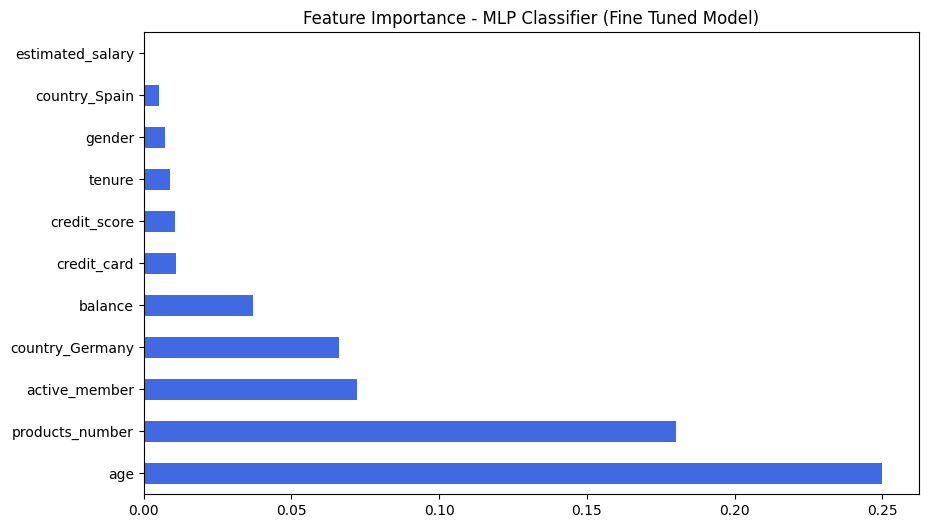

In [21]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
importances_sorted.plot(kind='barh', color='royalblue')
plt.title('Feature Importance - MLP Classifier (Fine Tuned Model)')
plt.savefig('../outputs/figures/model_feature_importance/mlp_fine_tuned_model_feature_importances.png', dpi=300, bbox_inches='tight')

plt.show()

<Figure size 640x480 with 0 Axes>